In [1]:
using Arpack
using LinearAlgebra
using CairoMakie
using LaTeXStrings
using Revise
using Interpolations
using Roots
using ColorSchemes
using Colors
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/Spinors/rmg_K.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/Lattice_setup/lattice_BZ.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/3P_funcs/patch_methods.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/3P_funcs/rmg_3pV.jl")

rmg_alpha_exp (generic function with 1 method)

In [2]:
function explicit_og_bc_vF(delta, alpha, index, vF)
    omega = exp(im * 2 * pi/ 3)
    k = index - 1
    v = vF
    
    nmz = 16 * real(omega^k * delta)^4 + 3 * abs(delta)^4 + 8 * real(delta^3) * real(omega^k * delta)
    
    return ((8 * sqrt(3) / nmz^2) * (8 * v * real(omega^k * delta)^3 - 12 * real(alpha * conj(delta)) * real(omega^k * delta)^2 + 
    3 * abs2(delta) * real(alpha * conj(delta)) + v * real(delta^3)) * (4 * real(omega^k * delta)^2 * imag(alpha * conj(delta)) + 
    4 * real(omega^k * delta) * imag(alpha * delta^2) - v * imag(delta^3) + abs2(delta) * imag(alpha * conj(delta))))
    
end

explicit_og_bc_vF (generic function with 1 method)

In [3]:
function approx_sign(x; tol=1e-15)
    if x > tol
        return 1
    elseif x < -tol
        return -1
    else
        return 0
    end
end

approx_sign (generic function with 1 method)

The idea of this notebook is that I would like to map out the "phase diagram" of the pure 3-patch Berry curvature. The only parameters that matter here for the sign are $\arg(\Delta), \arg(\alpha), \frac{v_F}{|\alpha|}$.

## Phase diagram of Berry curvature for individual bands

In [4]:
function phase_diagram_phi_theta(vF, k)
    n_pts = 10^2
    angles = range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\frac{1}{\pi}(\phi, \theta) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_theta (generic function with 1 method)

In [5]:
approx_sign(explicit_og_bc_vF(1, 1/2, 0 + 1, 0.1/2))

0

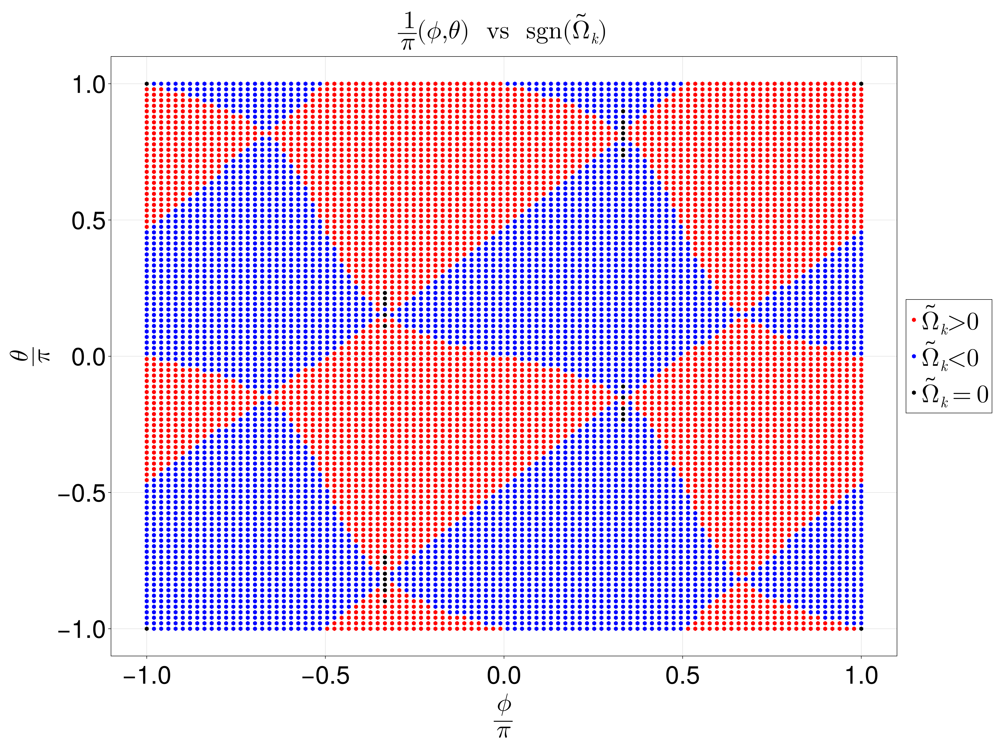

In [6]:
phase_diagram_phi_theta(0.1, 0)

In [7]:
function phase_diagram_phi_vF(theta, k)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        phi = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\phi}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\phi}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_vF (generic function with 1 method)

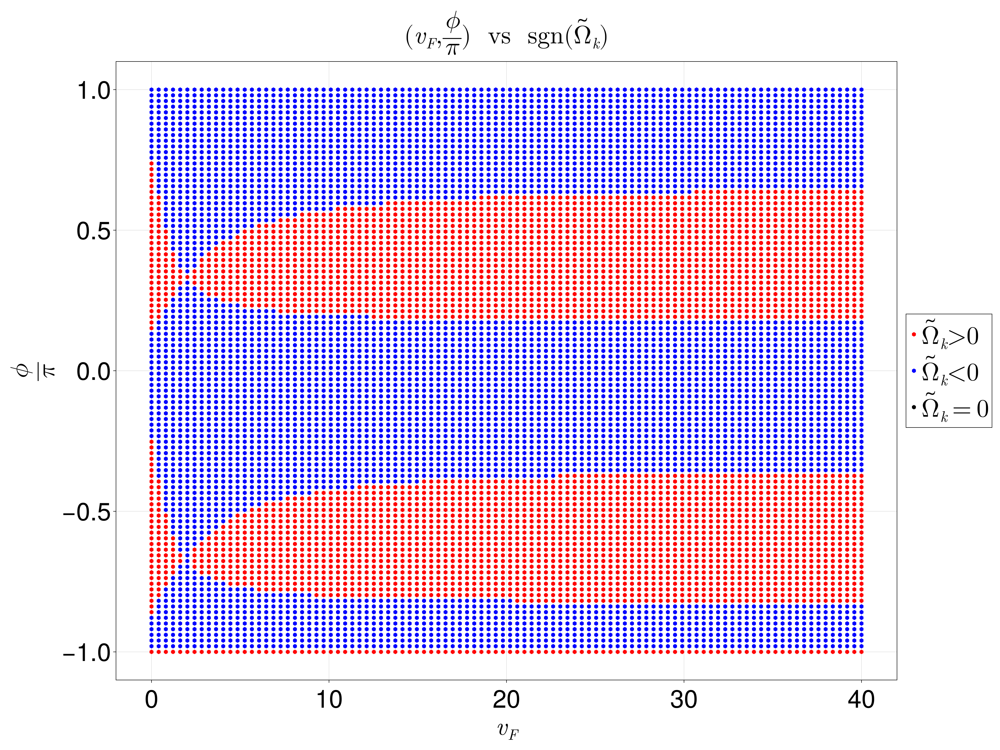

In [8]:
phase_diagram_phi_vF(pi/4, 2)

In [9]:
function phase_diagram_theta_vF(phi, k)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        theta = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\theta}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_theta_vF (generic function with 1 method)

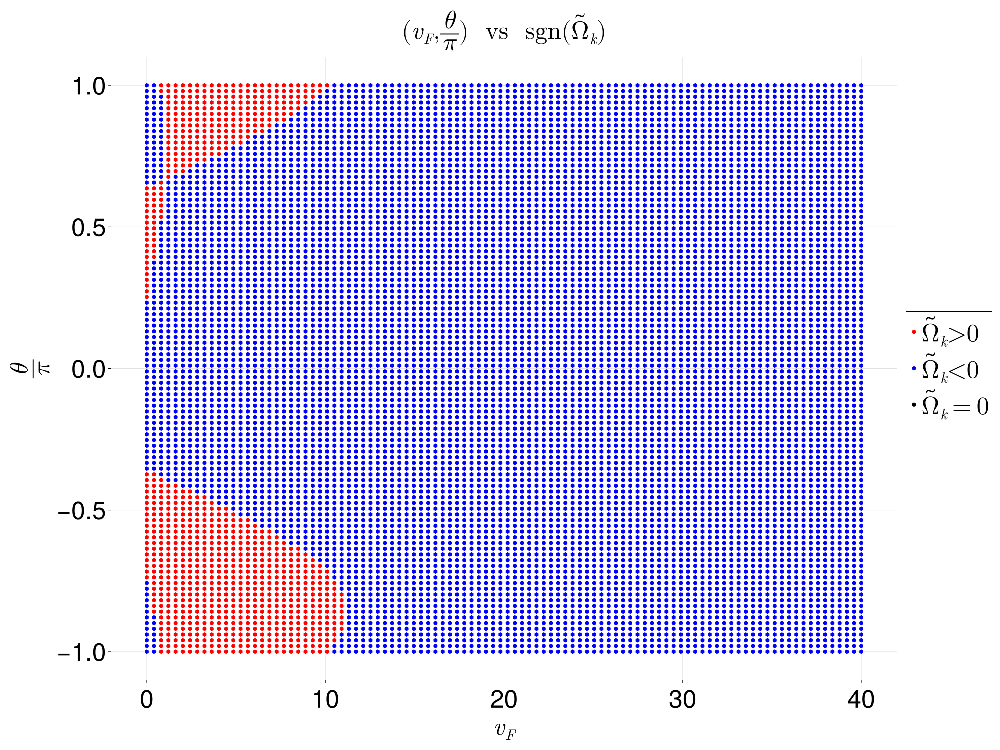

In [10]:
phase_diagram_theta_vF(7*pi/4, 2)

In [11]:
function phase_diagram_phi_vF_min(theta)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        phi = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        eigenvals = vF_analytic_eigenvalues(alpha/2, delta, 0, 0, vF/2)
        k = argmin(eigenvals)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\phi}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\phi}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_vF_min (generic function with 1 method)

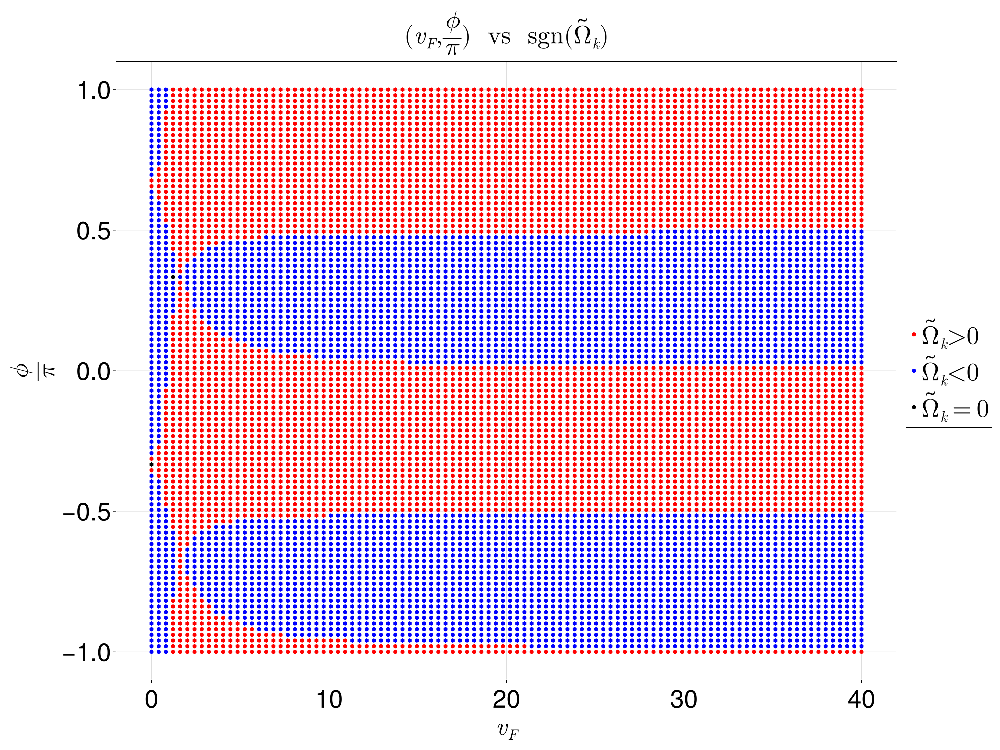

In [12]:
phase_diagram_phi_vF_min(pi/7)

In [13]:
function phase_diagram_theta_vF_min(phi)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        theta = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        eigenvals = vF_analytic_eigenvalues(alpha/2, delta, 0, 0, vF/2)
        k = argmin(eigenvals)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\theta}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_theta_vF_min (generic function with 1 method)

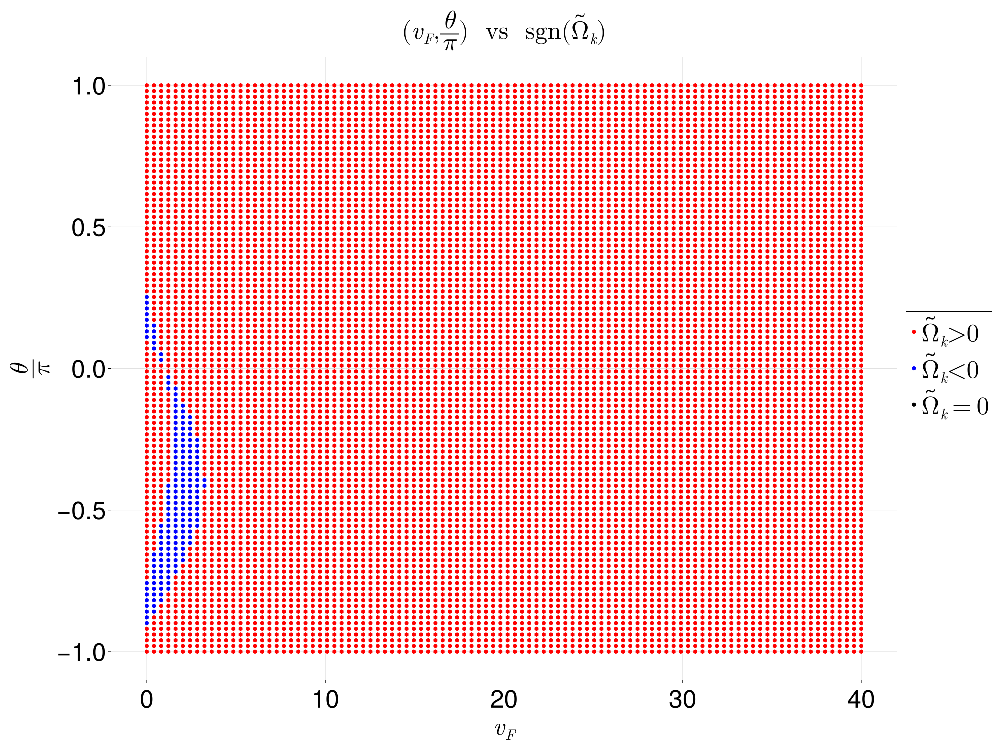

In [14]:
phase_diagram_theta_vF_min(3*pi/5)

## Analytic phase boundary plots

In [15]:
function wrap_angle(ang)
    return mod(ang + pi, 2pi) - pi
end

wrap_angle (generic function with 1 method)

In [16]:
function branch1_theta(vF, a, phi, k)
    return wrap_angle((phi + acos(vF/a * (cos(3*phi) + 2 * cos(phi + 2*pi*k/3)) / (1 + 2 * cos(2*phi + 4 * pi * k / 3)))))
end

branch1_theta (generic function with 1 method)

In [17]:
function branch2_roots(vF, a, varphi, k, n)
    theta = wrap_angle(varphi - 2*pi/3 * k)
    phi = wrap_angle(n*pi + atan(3 * sin(varphi) / (vF/a - cos(varphi))) + pi/3 * k)
    return [phi, theta]
end

branch2_roots (generic function with 1 method)

In [18]:
function phase_boundary_vF(vF, a, k)
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], 
    title = L"\text{sgn}(\tilde{\Omega}_2) \text{ in } \frac{1}{\pi}(\phi, \theta) \text{ for } v_F/|\alpha| = 0.5", 
    xlabel = L"\frac{\phi}{\pi}", ylabel = L"\frac{\theta}{\pi}")

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax1, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax1, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_2 > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_2 < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_2 = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_boundary_vF (generic function with 1 method)

In [19]:
vF = 0.5
k = 2

2

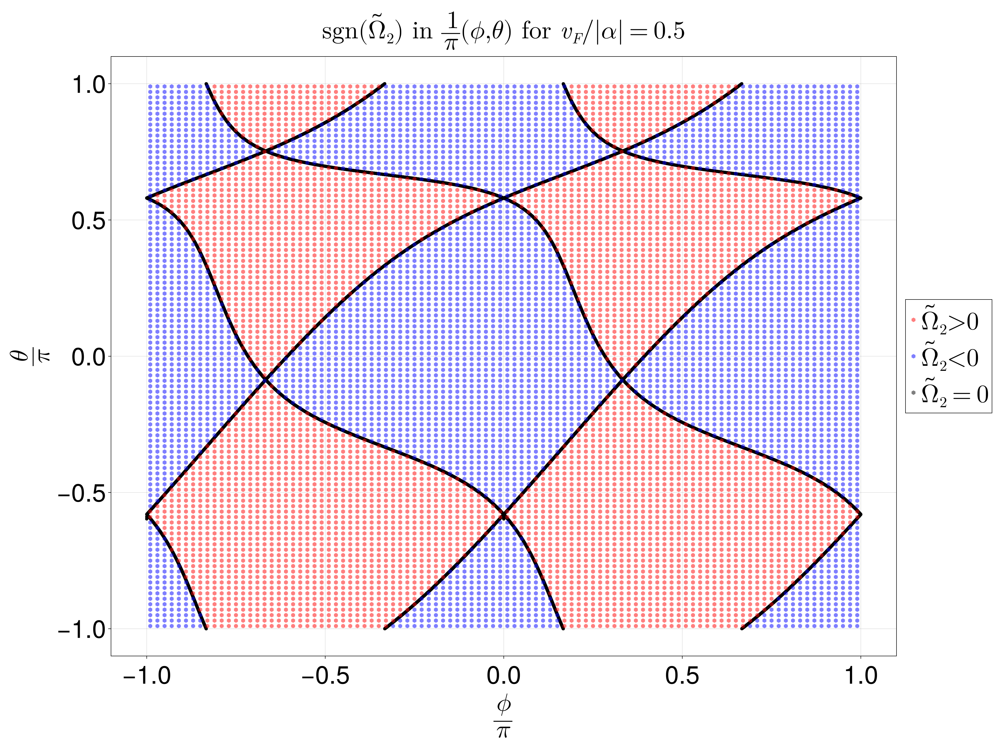

In [20]:
phase_boundary_vF(vF, 1, k)

## Now we can make a nice set of 4 phase diagrams for Tomo (proof of concept)

In [21]:
function phase_boundary_vF_grid_plot(vF_list, a, k)
    fig = Figure(size=(6000, 4000), fontsize=50, fonts = (; regular = "italic", weird = "bold"), figure_padding = 0)

    # (1, 1)
    vF = vF_list[1]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax1 = Axis(fig[1, 1], title = L"\ v_F = 0", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax1, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax1, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    # fig[1, 2] = Legend(fig, ax1, framevisible = true)

    



    # (1, 2)
    vF = vF_list[2]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax2 = Axis(fig[1, 2], title = L" v_F = 0.25", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax2, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax2, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax2, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax2, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax2, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    # fig[1, 2] = Legend(fig, ax1, framevisible = true)


    # (2, 1)
    vF = vF_list[3]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax3 = Axis(fig[2, 1], title = L"v_F = 0.5", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax3, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax3, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax3, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax3, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax3, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    # fig[1, 2] = Legend(fig, ax1, framevisible = true)





    # (2, 2)
    vF = vF_list[4]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax4 = Axis(fig[2, 2], title = L"v_F = 0.75", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax4, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax4, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax4, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax4, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax4, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    
    axs = Axis(fig[:, :], 
    title = L"\text{Phase diagram in } \frac{1}{\pi}(\phi, \theta) \ \text{plane for } k = 2", titlegap = 150, titlesize = 120)
    hidedecorations!(axs, label = false)
    hidespines!(axs)


    legend =  Legend(fig[:, 3], ax1, framevisible = true, fontsize = 100)

    fig
end

phase_boundary_vF_grid_plot (generic function with 1 method)

In [22]:
vF_list = [0, 0.25, 0.5, 0.75]
phase_boundary_vF_grid_plot(vF_list, 1, 2)

## RMG uniform potential phase diagram

We first assume a 3-patch potential that acts uniformly across all $N_L$ layers. We compute $\Delta, \alpha$ via this potential and plot the sign of Berry curvature in the $(v_F, \nu)$ plane

In [23]:
function branch1_vF(a, theta, phi, k)
    return (3 * a * cos(theta - phi) * (4 * cos(phi + 2 * pi / 3 * k)^2 - 1) / (8 * cos(phi + 2 * pi / 3 * k)^3 + cos(3 * phi)))
end

branch1_vF (generic function with 1 method)

In [24]:
function branch2_vF(a, theta, phi, k)
    return ((a / sin(3 * phi)) * (4 * cos(phi + 2 * pi / 3 * k)^2 * sin(theta - phi) + 4 * cos(phi + 2 * pi / 3 * k) * sin(theta + 2 * phi) + 
    sin(theta - phi)))
end

branch2_vF (generic function with 1 method)

In [25]:
function phase_boundary_RMG_uniform(m_kappa, NL)
    """ Delta and alpha depend exclusively on NL, nu, m_kappa. Let's first plot the phase diagram and then worry about 
    adding in the phase boundary later.
    """
    vF_llm = 0
    vF_ulm = 1
    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\text{sgn}(\tilde{\Omega}) \text{ in } (v_F, \nu) \text{ for } V^\ell = V", 
    xlabel = L"v_F", ylabel = L"\nu")
    # plot the analytic phase boundaries
    n_pts = 10^4
    nu_list = range(0.000001, 0.9999999, n_pts)

    branch_1_vF = []
    branch_1_nu = []
    branch_2_vF = []
    branch_2_nu = []
    
    for j in 1:n_pts
        nu = nu_list[j]

        delta = rmg_delta_all(m_kappa, nu, NL)
        d = abs(delta)
        phi = wrap_angle(angle(delta))

        alpha = rmg_alpha_all(m_kappa, nu, NL)
        a = abs(alpha)
        theta = wrap_angle(angle(alpha))

        # vF does not change the order of eigenvalues
        if 0 < phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 < phi || phi < -2*pi/3
            k = 0
        elseif phi > -2*pi/3 && phi < 0
            k = 2
        end

        vF1 = branch1_vF(a, theta, phi, k)
        if vF1 >= vF_llm && vF1 < vF_ulm
            append!(branch_1_vF, vF1)
            append!(branch_1_nu, nu)
        end

        vF2 = branch2_vF(a, theta, phi, k)
        if vF2 >= vF_llm && vF2 < vF_ulm
            append!(branch_2_vF, vF2)
            append!(branch_2_nu, nu)
        end
    end

    if length(branch_1_vF) > 0
        scatter!(ax1, branch_1_vF, branch_1_nu, color = :black)
    end
    if length(branch_2_vF) > 0
        scatter!(ax1, branch_2_vF, branch_2_nu, color = :black)
    end
   
    

    # Plot the numeric phase diagram
    n_pts = 10^2
    nu_list = range(0.000001, 0.9999999, n_pts)
    vF_list = range(vF_llm + 0.000001, vF_ulm, n_pts)
    grid = mesh_grid(vF_list, nu_list, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        vF = grid[j, 1]
        nu = grid[j, 2]
        delta = rmg_delta_all(m_kappa, nu, NL)
        alpha = rmg_alpha_all(m_kappa, nu, NL)
        
        phi = wrap_angle(angle(delta))
        if 0 < phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 < phi || phi < -2*pi/3
            k = 0
        elseif phi > -2*pi/3 && phi < 0
            k = 2
        end
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(vF, nu))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(vF, nu))
        else
            push!(zero_points, Point2f(vF, nu))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega} > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega} < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega} = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_boundary_RMG_uniform (generic function with 1 method)

In [26]:
m_kappa = 1
NL = 5

5

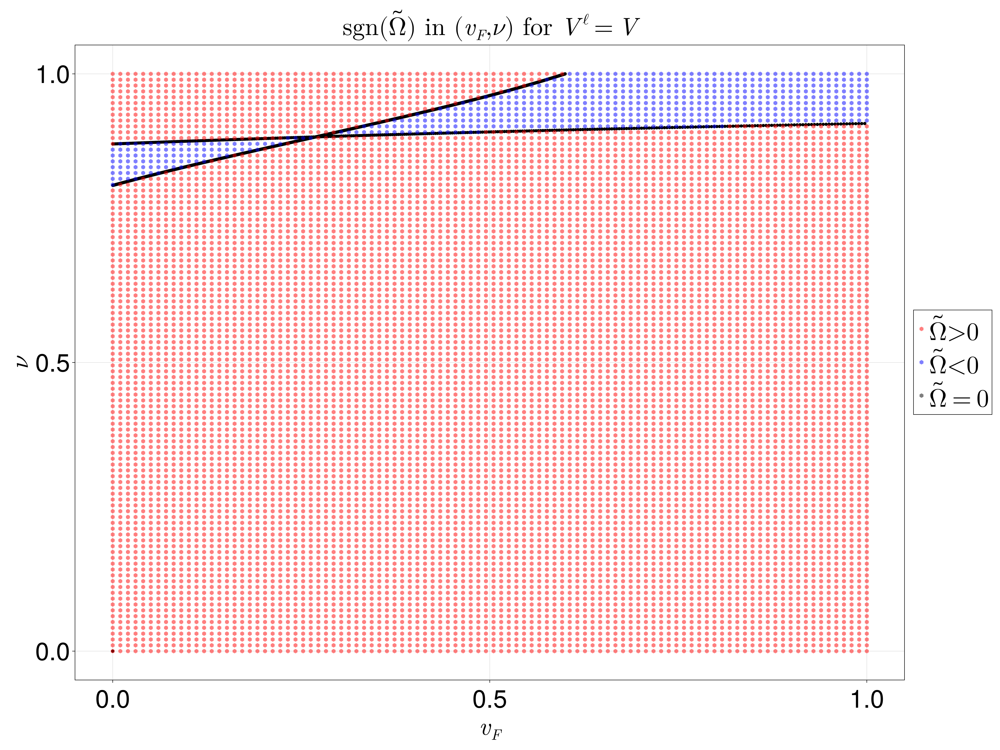

In [27]:
phase_boundary_RMG_uniform(m_kappa, NL)

## RMG Linear Potential Phase Diagram

In [28]:
function phase_boundary_RMG_linear(m_kappa, NL)
    """ Delta and alpha depend exclusively on NL, nu, m_kappa. Let's first plot the phase diagram and then worry about 
    adding in the phase boundary later.
    """
    vF_llm = 0
    vF_ulm = 1
    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\text{sgn}(\tilde{\Omega}) \text{ in } (v_F, \nu) \text{ for } V^\ell = V \ell", 
    xlabel = L"v_F", ylabel = L"\nu")
    # plot the analytic phase boundaries
    n_pts = 10^4
    nu_list = range(0.0001, 1, n_pts)

    branch_1_vF = []
    branch_1_nu = []
    branch_2_vF = []
    branch_2_nu = []
    
    for j in 1:n_pts
        nu = nu_list[j]

        delta = rmg_delta_linear(m_kappa, nu, NL)
        d = abs(delta)
        phi = wrap_angle(angle(delta))

        alpha = rmg_alpha_linear(m_kappa, nu, NL)
        a = abs(alpha)
        theta = wrap_angle(angle(alpha))

        # vF does not change the order of eigenvalues
        if 0 <= phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 <= phi || phi < -2*pi/3
            k = 0
        elseif phi >= -2*pi/3 && phi < 0
            k = 2
        end
        k = 0

        vF1 = branch1_vF(a, theta, phi, k)
        if vF1 >= vF_llm && vF1 <= vF_ulm
            append!(branch_1_vF, vF1)
            append!(branch_1_nu, nu)
        end

        vF2 = branch2_vF(a, theta, phi, k)
        if vF2 >= vF_llm && vF2 <= vF_ulm
            append!(branch_2_vF, vF2)
            append!(branch_2_nu, nu)
        end
    end

    if length(branch_1_vF) > 0
        scatter!(ax1, branch_1_vF, branch_1_nu, color = :black)
    end
    if length(branch_2_vF) > 0
        scatter!(ax1, branch_2_vF, branch_2_nu, color = :black)
    end
   
    

    # Plot the numeric phase diagram
    n_pts = 10^2
    nu_list = range(0.0001, 1, n_pts)
    vF_list = range(vF_llm, vF_ulm, n_pts)
    grid = mesh_grid(vF_list, nu_list, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        vF = grid[j, 1]
        nu = grid[j, 2]
        delta = rmg_delta_linear(m_kappa, nu, NL)
        alpha = rmg_alpha_linear(m_kappa, nu, NL)
        
        phi = wrap_angle(angle(delta))
        if 0 <= phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 <= phi || phi < -2*pi/3
            k = 0
        elseif phi >= -2*pi/3 && phi < 0
            k = 2
        end
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(vF, nu))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(vF, nu))
        else
            push!(zero_points, Point2f(vF, nu))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega} > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega} < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega} = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_boundary_RMG_linear (generic function with 1 method)

In [29]:
m_kappa = 1
NL = 3

3

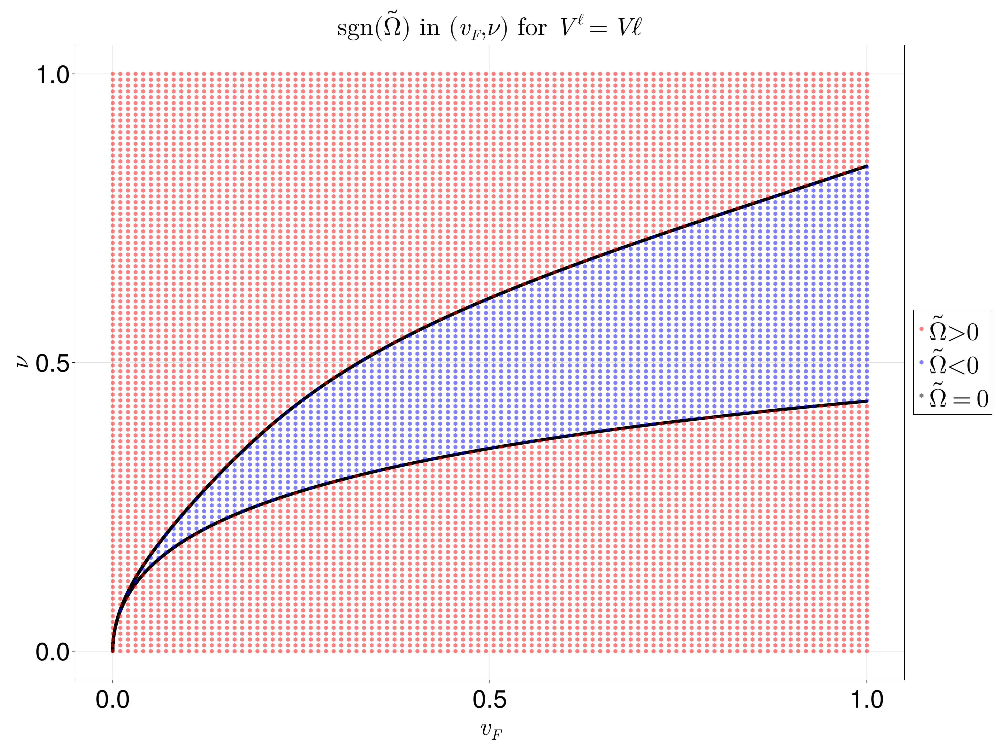

In [30]:
phase_boundary_RMG_linear(m_kappa, NL)

## RMG Exponential Potential Phase Diagram

In [31]:
function phase_boundary_RMG_exp(m_kappa, NL)
    """ Delta and alpha depend exclusively on NL, nu, m_kappa. Let's first plot the phase diagram and then worry about 
    adding in the phase boundary later.
    """
    vF_llm = 0
    vF_ulm = 2
    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\text{Phase diagram for } V_\ell = e^\ell \text{, } N_L = 3", xlabel = L"v_F", 
    ylabel = L"\nu")
    # plot the analytic phase boundaries
    n_pts = 10^4
    nu_list = range(0, 1, n_pts)

    branch_1_vF = []
    branch_1_nu = []
    branch_2_vF = []
    branch_2_nu = []
    
    for j in 1:n_pts
        nu = nu_list[j]

        delta = rmg_delta_exp(m_kappa, nu, NL)
        d = abs(delta)
        phi = wrap_angle(angle(delta))

        alpha = rmg_alpha_exp(m_kappa, nu, NL)
        a = abs(alpha)
        theta = wrap_angle(angle(alpha))

        # vF does not change the order of eigenvalues
        if 0 <= phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 <= phi || phi < -2*pi/3
            k = 0
        elseif phi >= -2*pi/3 && phi < 0
            k = 2
        end

        vF1 = branch1_vF(a, theta, phi, k)
        if vF1 >= vF_llm && vF1 <= vF_ulm
            append!(branch_1_vF, vF1)
            append!(branch_1_nu, nu)
        end

        vF2 = branch2_vF(a, theta, phi, k)
        if vF2 >= vF_llm && vF2 <= vF_ulm
            append!(branch_2_vF, vF2)
            append!(branch_2_nu, nu)
        end
    end

    if length(branch_1_vF) > 0
        scatter!(ax1, branch_1_vF, branch_1_nu, color = :black)
    end
    if length(branch_2_vF) > 0
        scatter!(ax1, branch_2_vF, branch_2_nu, color = :black)
    end
   
    

    # Plot the numeric phase diagram
    n_pts = 10^2
    nu_list = range(0, 1, n_pts)
    vF_list = range(vF_llm, vF_ulm, n_pts)
    grid = mesh_grid(vF_list, nu_list, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        vF = grid[j, 1]
        nu = grid[j, 2]
        delta = rmg_delta_exp(m_kappa, nu, NL)
        alpha = rmg_alpha_exp(m_kappa, nu, NL)
        
        phi = wrap_angle(angle(delta))
        if 0 <= phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 <= phi || phi < -2*pi/3
            k = 0
        elseif phi >= -2*pi/3 && phi < 0
            k = 2
        end
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(vF, nu))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(vF, nu))
        else
            push!(zero_points, Point2f(vF, nu))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega} > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega} < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega} = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_boundary_RMG_exp (generic function with 1 method)

In [32]:
m_kappa = 1
NL = 3

3

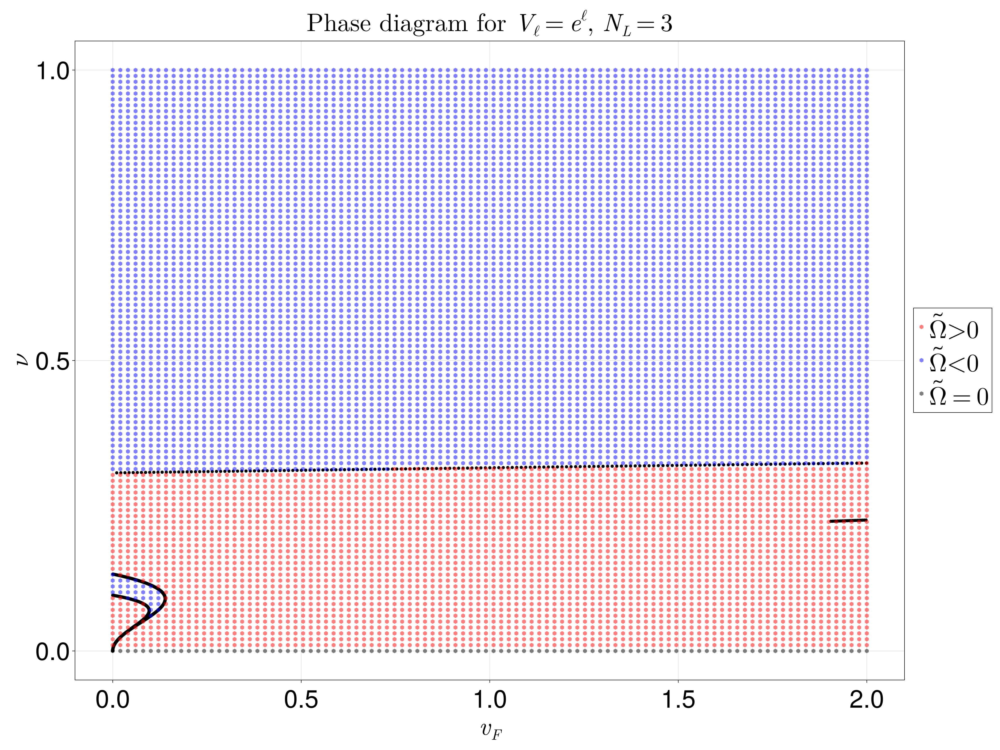

In [33]:
phase_boundary_RMG_exp(m_kappa, NL)

## Phase diagram of Berry curvature for lowest energy band

In [109]:
function phase_diagram_phi_theta_min(vF, a)
    omega = exp(im * 2 * pi / 3)
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots_1_phi = []
    branch_2_roots_1_theta = []

    branch_2_roots_2_phi = []
    branch_2_roots_2_theta = []

    branch_2_roots_3_phi = []
    branch_2_roots_3_theta = []

    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        phim1 = wrap_angle(varphi - pi)
        phi0 = wrap_angle(varphi)
        phip1 = wrap_angle(varphi + pi)

        # Branch 1 roots first
        if 0 < phim1 && phim1 <= 2*pi/3
            km1 = 1
        elseif 2*pi/3 < phim1 || phim1 <= -2*pi/3
            km1 = 0
        elseif phim1 > -2*pi/3 && phim1 <= 0
            km1 = 2
        end

        if 0 < phi0 && phi0 <= 2*pi/3
            k0 = 1
        elseif 2*pi/3 < phi0 || phi0 <= -2*pi/3
            k0 = 0
        elseif phi0 > -2*pi/3 && phi0 <= 0
            k0 = 2
        end

        if 0 < phip1 && phip1 <= 2*pi/3
            kp1 = 1
        elseif 2*pi/3 < phip1 || phip1 <= -2*pi/3
            kp1 = 0
        elseif phip1 > -2*pi/3 && phip1 <= 0
            kp1 = 2
        end

        branch_1_roots[1, 1, j] = phim1
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], km1)

        branch_1_roots[2, 1, j] = phi0
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k0)

        branch_1_roots[3, 1, j] = phip1
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], kp1)


        # Branch 2 roots
        roots_b2_temp = Array{Float64}(undef, 3, 2)
        roots_b2_temp[1, :] = branch2_roots(vF, a, varphi, 0, -1)
        roots_b2_temp[2, :] = branch2_roots(vF, a, varphi, 1, -1)
        roots_b2_temp[3, :] = branch2_roots(vF, a, varphi, 2, -1)

        for i in 1:3
            phi = roots_b2_temp[i, 1]
            if 0 < phi && phi <= 2*pi/3
                k = 1
            elseif 2*pi/3 < phi || phi <= -2*pi/3
                k = 0
            elseif phi > -2*pi/3 && phi <= 0
                k = 2
            end
            if k == i - 1
                push!(branch_2_roots_1_phi, roots_b2_temp[i, 1])
                push!(branch_2_roots_1_theta, roots_b2_temp[i, 2])
            end
        end

        roots_b2_temp = Array{Float64}(undef, 3, 2)
        roots_b2_temp[1, :] = branch2_roots(vF, a, varphi, 0, 0)
        roots_b2_temp[2, :] = branch2_roots(vF, a, varphi, 1, 0)
        roots_b2_temp[3, :] = branch2_roots(vF, a, varphi, 2, 0)

        for i in 1:3
            phi = roots_b2_temp[i, 1]
            if 0 < phi && phi <= 2*pi/3
                k = 1
            elseif 2*pi/3 < phi || phi <= -2*pi/3
                k = 0
            elseif phi > -2*pi/3 && phi <= 0
                k = 2
            end
            if k == i - 1
                push!(branch_2_roots_2_phi, roots_b2_temp[i, 1])
                push!(branch_2_roots_2_theta, roots_b2_temp[i, 2])
            end
        end
        

        roots_b2_temp = Array{Float64}(undef, 3, 2)
        roots_b2_temp[1, :] = branch2_roots(vF, a, varphi, 0, 1)
        roots_b2_temp[2, :] = branch2_roots(vF, a, varphi, 1, 1)
        roots_b2_temp[3, :] = branch2_roots(vF, a, varphi, 2, 1)

        for i in 1:3
            phi = roots_b2_temp[i, 1]
            if 0 < phi && phi <= 2*pi/3
                k = 1
            elseif 2*pi/3 < phi || phi <= -2*pi/3
                k = 0
            elseif phi > -2*pi/3 && phi <= 0
                k = 2
            end
            if k == i - 1
                push!(branch_2_roots_3_phi, roots_b2_temp[i, 1])
                push!(branch_2_roots_3_theta, roots_b2_temp[i, 2])
            end
        end

       
    end
    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], 
    title = L"\text{sgn}(\tilde{\Omega}) \text{ in } \frac{1}{\pi}(\phi, \theta) \text{ for } v_F/|\alpha| = 0.5", 
    xlabel = L"\frac{\phi}{\pi}", ylabel = L"\frac{\theta}{\pi}")

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax1, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    
    # Some reshaping
    b2_roots_1 = Array{Float64}(undef, 2, size(branch_2_roots_1_phi, 1))
    b2_roots_1[1, :] = branch_2_roots_1_phi
    b2_roots_1[2, :] = branch_2_roots_1_theta

    b2_roots_2 = Array{Float64}(undef, 2, size(branch_2_roots_2_phi, 1))
    b2_roots_2[1, :] = branch_2_roots_2_phi
    b2_roots_2[2, :] = branch_2_roots_2_theta

    b2_roots_3 = Array{Float64}(undef, 2, size(branch_2_roots_3_phi, 1))
    b2_roots_3[1, :] = branch_2_roots_3_phi
    b2_roots_3[2, :] = branch_2_roots_3_theta

   
    scatter!(ax1, 1/pi * b2_roots_1[1, :], 1/pi * b2_roots_1[2, :], color = :black)
    scatter!(ax1, 1/pi * b2_roots_2[1, :], 1/pi * b2_roots_2[2, :], color = :black)
    scatter!(ax1, 1/pi * b2_roots_3[1, :], 1/pi * b2_roots_3[2, :], color = :black)



    # Add vertical boundaries for brand crossings
    n_pts = 10^3
    phase_b1 = Array{Float64}(undef, 2, n_pts)
    phase_b1[2, :] = range(-1, 1, n_pts)
    phase_b1[1, :] = -2/3 * ones(n_pts)

    phase_b2 = Array{Float64}(undef, 2, n_pts)
    phase_b2[2, :] = range(-1, 1, n_pts)
    phase_b2[1, :] = zeros(n_pts)

    phase_b3 = Array{Float64}(undef, 2, n_pts)
    phase_b3[2, :] = range(-1, 1, n_pts)
    phase_b3[1, :] = 2/3 * ones(n_pts)

    lines!(ax1, phase_b1[1, :], phase_b1[2, :], color = :black; linestyle = (:dash, :dense), linewidth = 7)
    lines!(ax1, phase_b2[1, :], phase_b2[2, :], color = :black; linestyle = (:dash, :dense), linewidth = 7)
    lines!(ax1, phase_b3[1, :], phase_b3[2, :], color = :black; linestyle = (:dash, :dense), linewidth = 7)

    # Plot Berry curvatures signs
    n_pts = 10^2
    angles = range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = exp(im * theta)
        phi = wrap_angle(angle(delta))
        if 0 < phi && phi < 2*pi/3
            k = 1
        elseif 2*pi/3 < phi || phi < -2*pi/3
            k = 0
        elseif phi > -2*pi/3 && phi < 0
            k = 2
        end
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    
    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega} > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega} < 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_theta_min (generic function with 1 method)

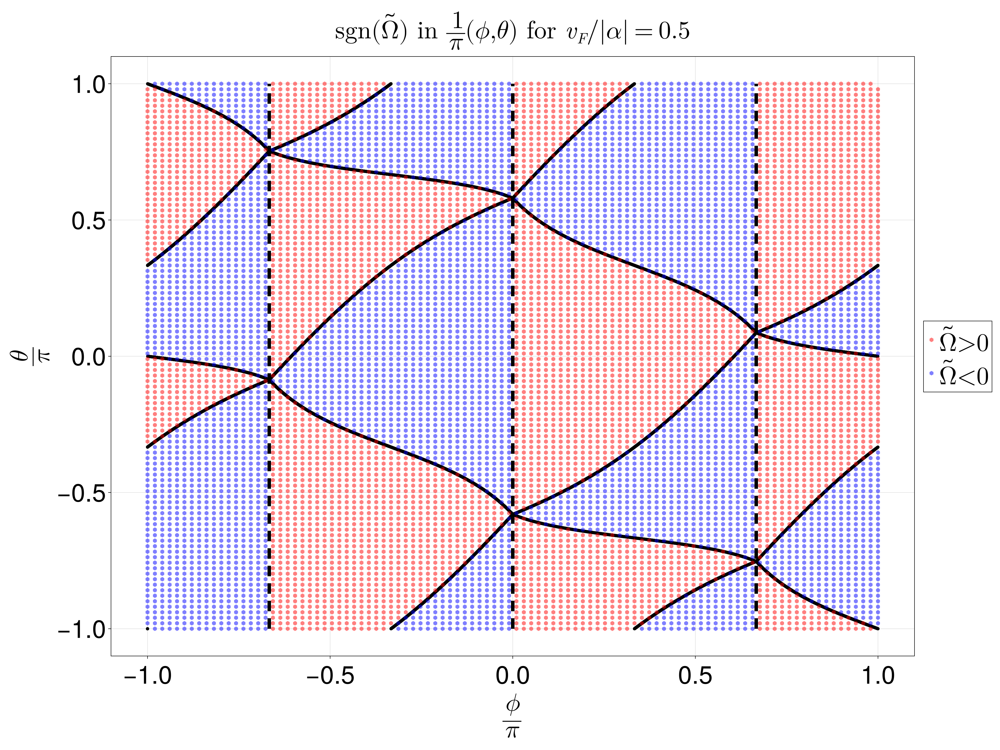

In [110]:
phase_diagram_phi_theta_min(0.5, 1)